In [19]:
from sklearn.datasets import fetch_20newsgroups

from lime.lime_text import LimeTextExplainer
from treeinterpreter import treeinterpreter

import sampyl as smp
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import re

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score, accuracy_score, roc_curve
from sklearn.linear_model import LogisticRegression

%matplotlib inline

In [2]:
train_data = fetch_20newsgroups(subset='train')
test_data  = fetch_20newsgroups(subset='test')

### Only keeping Atheist / christian

In [3]:
athe = train_data.target_names.index('alt.atheism')
chri = train_data.target_names.index('soc.religion.christian')

train_idx = np.where((train_data.target == athe) | (train_data.target == chri))[0]
test_idx = np.where((test_data.target == athe) | (test_data.target == chri))[0]

In [4]:
# Keeping only atheism & christianity articles
train_x = [d for d,t in zip(train_data.data, train_data.target) if (t == athe or t == chri)]
test_x  = [d for d,t in zip(test_data.data, test_data.target) if (t == athe or t == chri)]

train_y = [1 if t == chri else 0 for t in train_data.target if (t == athe or t == chri)]
test_y  = [1 if t == chri else 0 for t in test_data.target if (t == athe or t == chri)]

### Uncleaned test set - cleaned validation set

Let's simulate a usecase where the test set is of the same kind of the training set (ie: uncleaned, with irrelevant data). Then let's apply our model on a cleaned set, to test the (un)generalization capabilities of the model.

Here cleaning means removing the header from the 20 news group articles, and removing the quotes from previous messages.

In [5]:
siz = int(len(test_x) / 2)

valid_x = test_x[siz:]
valid_y = test_y[siz:]

test_x  = test_x[:siz]
test_y  = test_y[:siz]

In [6]:
# Cleaning validation set
e = r"([^\n]+\n)*\n((.|\s)*)$" # Matching header
p = re.compile(e, re.MULTILINE)

valid_clean = []

for d in valid_x:
    no_head = p.match(d).group(2)
    # Then removing quotes: lines starting by an email address or >
    no_quotes = re.sub(r"([a-zA-Z0-9_.+-]+@[a-zA-Z0-9-]+\.[a-zA-Z0-9-.]+|>|(In article)|(In <)).*\n", "", no_head)
    valid_clean.append(no_quotes)
    
valid_x = valid_clean

In [7]:
tfidf = TfidfVectorizer()
tfidf.fit(train_x)
train_tfidf = tfidf.transform(train_x)

In [8]:
rf = RandomForestClassifier(n_estimators=100, max_depth=15)

rf.fit(train_tfidf, train_y)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=15, max_features='auto', max_leaf_nodes=None,
            min_impurity_split=1e-07, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators=100, n_jobs=1, oob_score=False, random_state=None,
            verbose=0, warm_start=False)

### ROC AUC score of the model

In [9]:
test_tfidf  = tfidf.transform(test_x)
valid_tfidf = tfidf.transform(valid_x)

pred_test = rf.predict_proba(test_tfidf)
pred_valid = rf.predict_proba(valid_tfidf)

print('ROC AUC Score on test set:      ', roc_auc_score(test_y, pred_test[:,1]))
print('ROC AUC Score on validation set:', roc_auc_score(valid_y, pred_valid[:,1]))

ROC AUC Score on test set:       0.983666175502
ROC AUC Score on validation set: 0.842486651411


/Users/marcbeillevaire/anaconda/envs/datapred/lib/python3.6/site-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated since IPython 4.0. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)


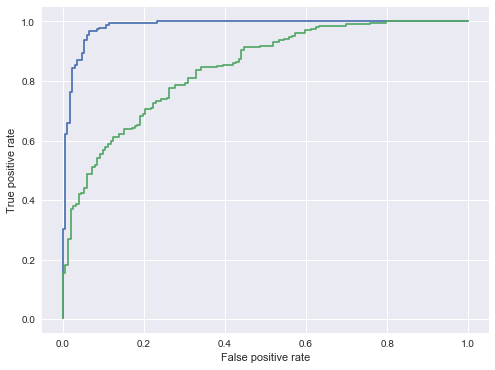

In [10]:

fpr_t, tpr_t, thres_t = roc_curve(test_y, pred_test[:,1])
fpr_v, tpr_v, thres_v = roc_curve(valid_y, pred_valid[:,1])

fig = plt.figure(figsize=(8,6))
plt.plot(fpr_t, tpr_t, '-')
plt.plot(fpr_v, tpr_v, '-')
plt.ylabel('True positive rate')
plt.xlabel('False positive rate')
plt.savefig('../report/img/roc-1.svg')
plt.show()

## Explaining

In [12]:
#examples = np.random.randint(0, len(test_x), 20)
examples = np.array([175, 321, 146, 348, 324, 223, 209, 222, 203, 107, 100,  96, 112,
       274, 215, 102, 115, 276, 204, 248])
examples

array([175, 321, 146, 348, 324, 223, 209, 222, 203, 107, 100,  96, 112,
       274, 215, 102, 115, 276, 204, 248])

## Explaining - LIME

**TODO (?):**

- Regarder les trucs missclassifiés dans le validation set
- enlever les mots cheuls


In [11]:
classif_fn = lambda x: rf.predict_proba(tfidf.transform(x))

In [13]:
for idx in examples:
    instance = test_x[idx]
    truth    = test_y[idx]
    predict  = pred_test[idx]

    #print 'Truth:  ', truth
    #print 'Predict:', predict[1]

    explainer = LimeTextExplainer(kernel_width=100, verbose=False, class_names=['atheism', 'christian'])
    exp = explainer.explain_instance(instance, classif_fn, [truth], num_features=10)

    exp.show_in_notebook()

/Users/marcbeillevaire/anaconda/envs/datapred/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


### Removing irrelevant words that have too much impact

In [14]:
irrelevant = set(['Re', 'Nntp', 'Posting', 'Host', 'article', '.edu', 'bil@', 'okcforum', 'edu', 'writes', 
                  'uk', 'Re', 're', 'NNTP', 'Distribution', 'Dwyer', 'solntze', 'sgi', 'Posting', 'Host', 
                  'article', '.com', '1993', 'athos.rutgers.edu', 'rice.edu', 'UUCP', 'vice.ICO', 'bobbe@', 
                  'Beauchaine', '.com', 'geneva.rutgers', 'rutgers.edu', 'cmu', 'umd.edu', 'PSUVM', 're', 'Re',
                  'rice.edu', 'wrote', 'Institute of Technology', 'saturn.wwc', 'Distribution', 'nih.gov'])
print(len(irrelevant))

34


In [15]:
# improved train & test sets
train_im_x = list(train_x)
test_im_x  = list(test_x)

for w in irrelevant:
    print(w),
    train_im_x = [t.replace(w, '') for t in train_im_x]
    test_im_x = [t.replace(w, '') for t in test_im_x]

1993
Dwyer
okcforum
sgi
edu
UUCP
writes
uk
re
wrote
saturn.wwc
bobbe@
vice.ICO
.com
rutgers.edu
umd.edu
geneva.rutgers
Beauchaine
Re
Institute of Technology
athos.rutgers.edu
Nntp
rice.edu
Host
solntze
Posting
PSUVM
.edu
NNTP
Distribution
bil@
cmu
nih.gov
article


In [16]:
# Retraining a similar model:
tfidf = TfidfVectorizer()
tfidf.fit(train_im_x)
train_im_tfidf = tfidf.transform(train_im_x)
test_im_tfidf  = tfidf.transform(test_im_x)
valid_tfidf    = tfidf.transform(valid_x)

rf = RandomForestClassifier(n_estimators=300, max_depth=8)
rf.fit(train_im_tfidf, train_y)

pred_test  = rf.predict_proba(test_im_tfidf)
pred_valid = rf.predict_proba(valid_tfidf)

ROC AUC Score on test set:       0.950246104649
ROC AUC Score on validation set: 0.894419018561


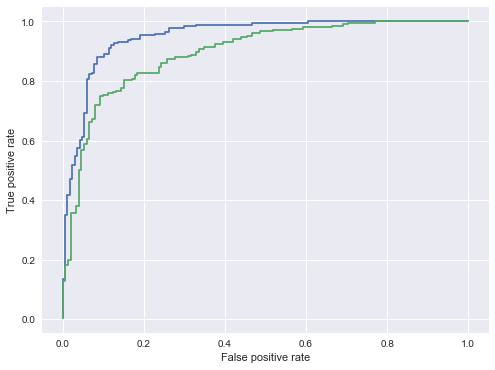

In [17]:
fpr_t, tpr_t, thres_t = roc_curve(test_y, pred_test[:,1])
fpr_v, tpr_v, thres_v = roc_curve(valid_y, pred_valid[:,1])

print('ROC AUC Score on test set:      ', roc_auc_score(test_y, pred_test[:,1]))
print('ROC AUC Score on validation set:', roc_auc_score(valid_y, pred_valid[:,1]))

fig = plt.figure(figsize=(8,6))
plt.plot(fpr_t, tpr_t, '-')
plt.plot(fpr_v, tpr_v, '-')
plt.ylabel('True positive rate')
plt.xlabel('False positive rate')
plt.savefig('../report/img/roc-lime.svg')
plt.show()

## Explaining - Treeinterpreter

In [19]:
examples = [60, 92, 187, 156, 259, 238,  42,  73, 329, 208, 301, 114, 345,
       219, 244,  19, 259,  32, 219, 100]
contribs = []
for idx in examples:
    instances = tfidf.transform([test_x[idx]])
    truth     = test_y[idx]
    predict   = pred_test[idx]

    print("Explaining...")
    pred, bias, contrib = treeinterpreter.predict(rf, instances)
    c = pd.Series(contrib[0,:,1], index=tfidf.get_feature_names())
    contribs.append(c.reindex(c.abs().sort_values(ascending=False).index))
    print(c.reindex(c.abs().sort_values(ascending=False).index).iloc[:40])

Explaining...
athos           0.022226
com            -0.018075
rutgers         0.015711
jesus           0.012042
heaven          0.009610
christ         -0.005921
may             0.005202
we              0.005068
with            0.005038
01              0.004656
love            0.004605
god             0.004457
edu            -0.004456
atheists        0.004060
lawrence       -0.003829
the            -0.003586
keith           0.003074
apr            -0.003070
hell            0.003060
christianity    0.003059
you             0.003050
article        -0.002868
houston         0.002857
08              0.002838
fine           -0.002720
enough          0.002708
us              0.002579
allan           0.002513
and             0.002405
atheism         0.002397
of             -0.002344
schneider       0.002313
church         -0.002302
our            -0.002301
world          -0.002255
livesey         0.002196
caltech         0.002118
islamic         0.002040
his             0.002022
christians 

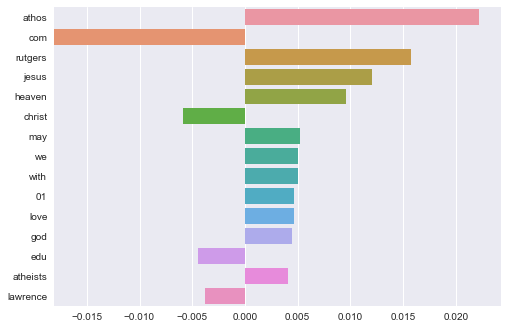

In [20]:
sns.barplot(contribs[0].iloc[:15], contribs[0].iloc[:15].index)
sns.plt.savefig("/Users/marcbeillevaire/Desktop/tree_interpreter.svg")

In [21]:
irrelevant = {"may", "com", "1993", "nntp", "posting", "01", "re", "co", "gmt", "ny", "host", "rutgers",
              "23", "article", "edu", "okcforum", "ma", "uk", "tm", "cu", "2000", "writes", 
              "apr", "clh", "uga", "wrote", "inc", "15", "schneider", "91605", "caltech", 
              "distribution", "clh", "cco", "de", "faq", "11", "03", "clh", "bil"}
print(len(irrelevant))

38


In [22]:
# improved train & test sets
train_im_x = list(train_x)
test_im_x  = list(test_x)

for w in irrelevant:
    print(w),
    train_im_x = [t.replace(w, '') for t in train_im_x]
    test_im_x = [t.replace(w, '') for t in test_im_x]

1993
distribution
11
bil
okcforum
edu
posting
ma
writes
uk
faq
re
wrote
host
ny
tm
clh
23
15
de
schneider
rutgers
co
com
uga
03
inc
cu
may
gmt
apr
nntp
caltech
91605
article
2000
01
cco


In [23]:
# Retraining a similar model:
tfidf = TfidfVectorizer()
tfidf.fit(train_im_x)
train_im_tfidf = tfidf.transform(train_im_x)
test_im_tfidf  = tfidf.transform(test_im_x)
valid_tfidf    = tfidf.transform(valid_x)

rf = RandomForestClassifier(n_estimators=300, max_depth=8)
rf.fit(train_im_tfidf, train_y)

pred_test  = rf.predict_proba(test_im_tfidf)
pred_valid = rf.predict_proba(valid_tfidf)

ROC AUC Score on test set:       0.971407969402
ROC AUC Score on validation set: 0.890128400712


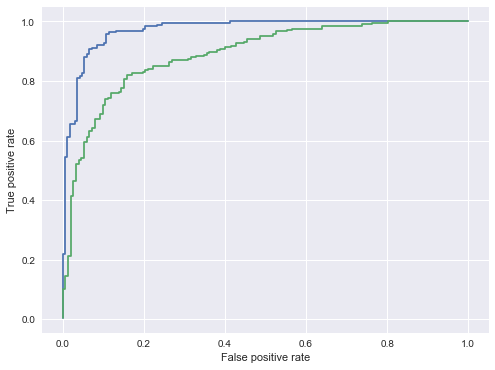

In [24]:
fpr_t, tpr_t, thres_t = roc_curve(test_y, pred_test[:,1])
fpr_v, tpr_v, thres_v = roc_curve(valid_y, pred_valid[:,1])


print('ROC AUC Score on test set:      ', roc_auc_score(test_y, pred_test[:,1]))
print('ROC AUC Score on validation set:', roc_auc_score(valid_y, pred_valid[:,1]))

fig = plt.figure(figsize=(8,6))
plt.plot(fpr_t, tpr_t, '-')
plt.plot(fpr_v, tpr_v, '-')
plt.ylabel('True positive rate')
plt.xlabel('False positive rate')
plt.savefig('../report/img/roc-treeinterpreter.svg')
plt.show()

## Linear model

In [9]:
lr = LogisticRegression(C=1)

tfidf.fit(train_x)
train_tfidf = tfidf.transform(train_x)
test_tfidf = tfidf.transform(test_x)
valid_tfidf = tfidf.transform(valid_x)

lr.fit(train_tfidf, train_y)

pred_test_lr = lr.predict_proba(test_tfidf)[:,1]
pred_valid_lr = lr.predict_proba(valid_tfidf)[:,1]

ROC AUC Score on test set:       0.976580869674
ROC AUC Score on validation set: 0.91733409611


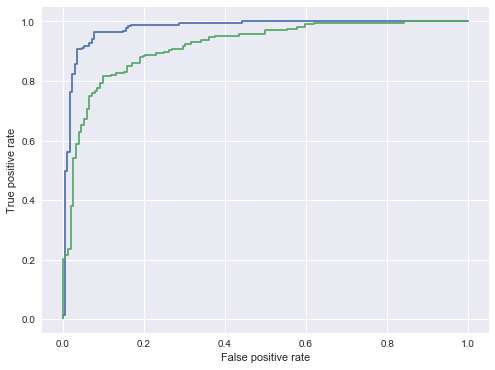

In [10]:
fpr_t, tpr_t, thres_t = roc_curve(test_y, pred_test_lr)
fpr_v, tpr_v, thres_v = roc_curve(valid_y, pred_valid_lr)

print('ROC AUC Score on test set:      ', roc_auc_score(test_y, pred_test_lr))
print('ROC AUC Score on validation set:', roc_auc_score(valid_y, pred_valid_lr))

fig = plt.figure(figsize=(8,6))
plt.plot(fpr_t, tpr_t, '-')
plt.plot(fpr_v, tpr_v, '-')
plt.ylabel('True positive rate')
plt.xlabel('False positive rate')
plt.savefig('../report/img/roc-lr.svg')
plt.show()

In [11]:
classif_fn = lambda x: lr.predict_proba(tfidf.transform(x))

for idx in examples:
    instance = test_x[idx]
    truth    = test_y[idx]
    predict  = pred_test[idx]

    #print 'Truth:  ', truth
    #print 'Predict:', predict[1]

    explainer = LimeTextExplainer(kernel_width=100, verbose=False, class_names=['atheism', 'christian'])
    exp = explainer.explain_instance(instance, classif_fn, [truth], num_features=10)

    exp.show_in_notebook()

NameError: name 'examples' is not defined

In [91]:
irrelevant = {"ai", "uga", "Michael", "Covington", "uxa", "uiuc", "edu", "Steve", "writes", "mangoe", 
              "umd", "Livesey", "cs", "NNTP", "Posting", "Host", "okcforum", "Bill", "psuvm", "psu"
              "wam", "livesey", "solntze", "wpd", "sgi", "com", "mathew", "mantis", "co", "uk", "Mantis", 
              "Newsreader", "UK", "Mussack"}
print(len(irrelevant))

33


In [92]:
# improved train & test sets
train_im_x = list(train_x)
test_im_x  = list(test_x)

for w in irrelevant:
    print(w),
    train_im_x = [t.replace(w, ' ') for t in train_im_x]
    test_im_x = [t.replace(w, ' ') for t in test_im_x]

mathew
okcforum
sgi
edu
UK
Mantis
writes
psuvm
Covington
uk
uxa
psuwam
umd
mangoe
wpd
Newsreader
livesey
Livesey
uiuc
Mussack
co
mantis
com
Host
uga
Steve
solntze
Bill
Posting
NNTP
ai
cs
Michael


In [93]:
# Retraining a similar model:
tfidf = TfidfVectorizer()
tfidf.fit(train_im_x)
train_im_tfidf = tfidf.transform(train_im_x)
test_im_tfidf  = tfidf.transform(test_im_x)
valid_tfidf    = tfidf.transform(valid_x)

lr = LogisticRegression(C=100)
lr.fit(train_im_tfidf, train_y)

pred_test_lr  = lr.predict_proba(test_im_tfidf)[:,1]
pred_valid_lr = lr.predict_proba(valid_tfidf)[:,1]

ROC AUC Score on test set:       0.98905853215
ROC AUC Score on validation set: 0.925661072972


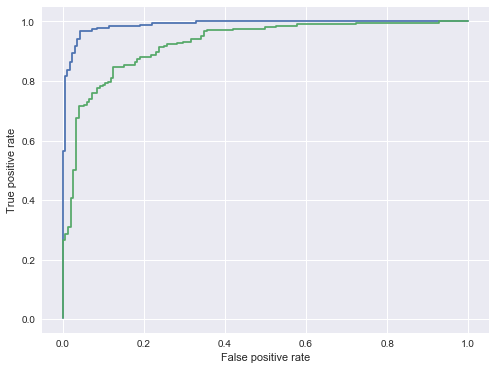

In [96]:
fpr_t, tpr_t, thres_t = roc_curve(test_y, pred_test_lr)
fpr_v, tpr_v, thres_v = roc_curve(valid_y, pred_valid_lr)

print('ROC AUC Score on test set:      ', roc_auc_score(test_y, pred_test_lr))
print('ROC AUC Score on validation set:', roc_auc_score(valid_y, pred_valid_lr))

fig = plt.figure(figsize=(8,6))
plt.plot(fpr_t, tpr_t, '-')
plt.plot(fpr_v, tpr_v, '-')
plt.ylabel('True positive rate')
plt.xlabel('False positive rate')
plt.savefig('../report/img/roc-lime-lr.svg')
plt.show()

### Linear model dept explanations

In [104]:
lr = LogisticRegression(C=1)

tfidf.fit(train_x)
train_tfidf = tfidf.transform(train_x)
test_tfidf = tfidf.transform(test_x)
valid_tfidf = tfidf.transform(valid_x)

lr.fit(train_tfidf, train_y)

pred_test_lr = lr.predict_proba(test_tfidf)[:,1]
pred_valid_lr = lr.predict_proba(valid_tfidf)[:,1]

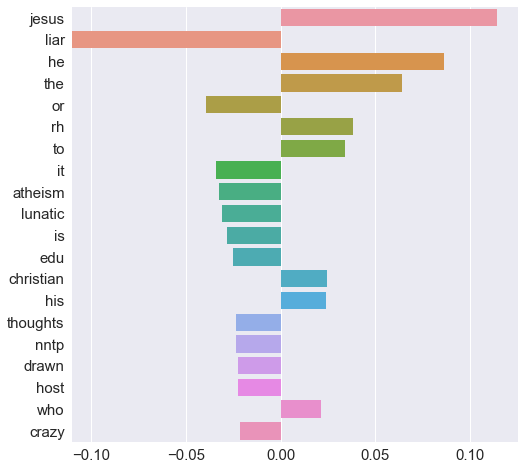

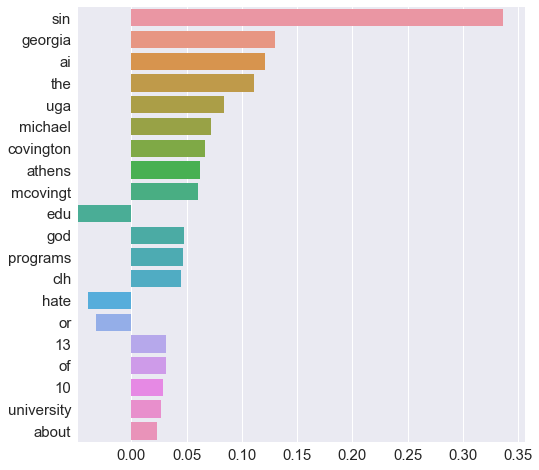

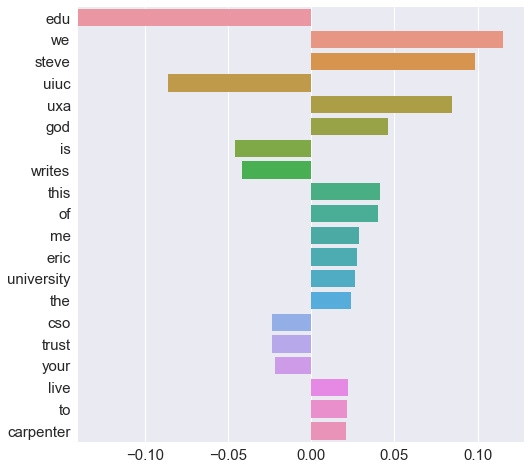

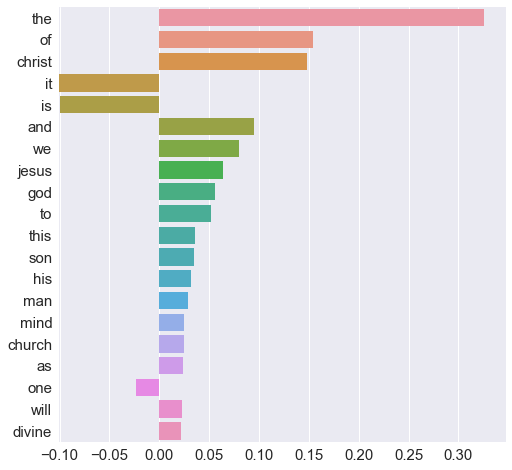

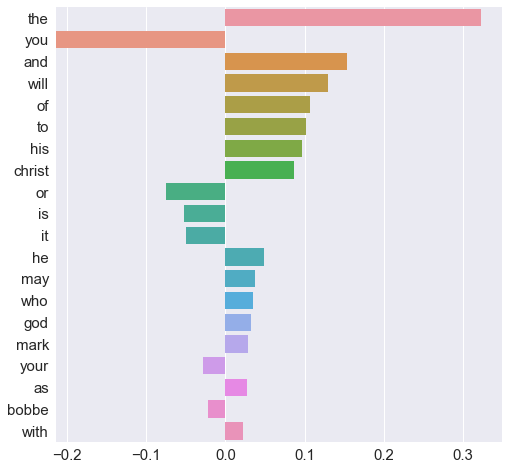

...

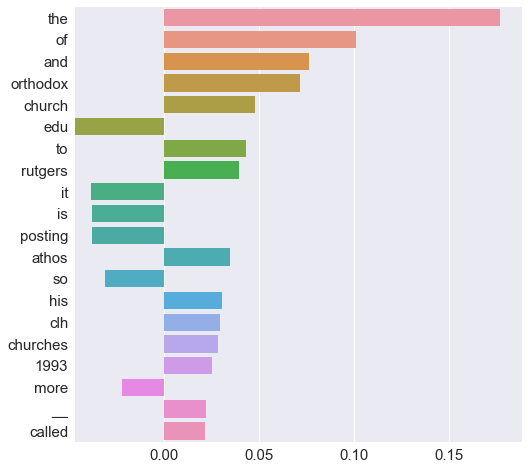

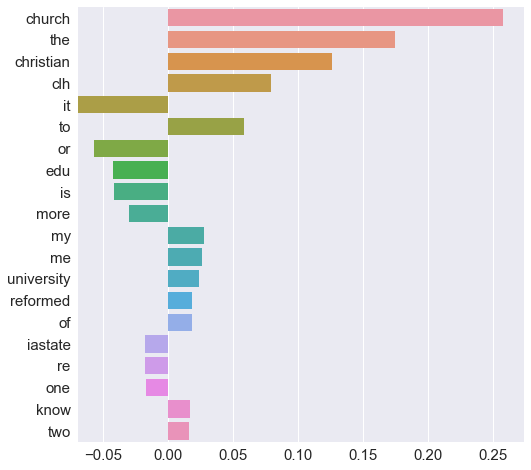

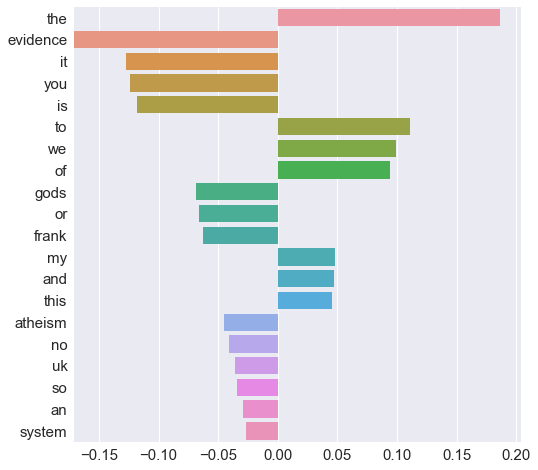

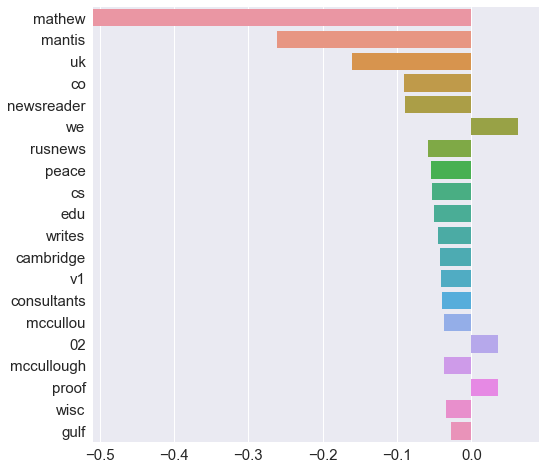

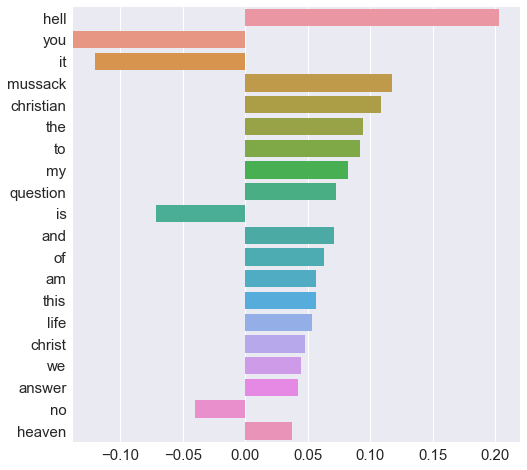

In [25]:
sns.set(font_scale=1.5)

for idx in examples:
    instance = test_x[idx]
    inst_tfidf = tfidf.transform([instance]).toarray()
    truth    = test_y[idx]
    predict  = pred_test_lr[idx]
    
    e = pd.Series((inst_tfidf * lr.coef_).reshape(-1),
                   index=tfidf.get_feature_names())
    
    e = e.reindex(e.abs().sort_values(ascending=False).index).head(20)
    sns.plt.figure(figsize=(8,8))
    sns.barplot(e.values, e.index)
    sns.plt.show()
    
sns.set(font_scale=1)

In [26]:
irrelevant = {"rh", "edu", "nntp", "NNTP", "host", "ai", "georgia", "uga", "michael", "covington", 
              "mconvingt", "edu", "clh", "steve", "uiuc", "uxa", "writes", "eric", "cso", "bobbe", 
              "mangoe", "umd", "livesey", "cs", "edu", "jon", "bil", "okcforum", "rb", "osrhe", 
              "posting", "bil", "umd", "psuvm", "jsn104", "ncsu", "sgi", "wpd", "solntze", "com", 
              "bu", "bcci", "uk", "clh", "mcl", "fi", "revdak", "mathew", "mantis", "UK", "co", "mussack"}
print(len(irrelevant))

47


In [31]:
# improved train & test sets
train_im_x = list(train_x)
test_im_x  = list(test_x)

for w in irrelevant:
    print(w),
    train_im_x = [t.replace(w, ' ') for t in train_im_x]
    test_im_x = [t.replace(w, ' ') for t in test_im_x]

co
ai
mathew
NNTP
umd
georgia
host
mcl
mangoe
steve
covington
solntze
jsn104
mantis
osrhe
bcci
okcforum
rb
mconvingt
writes
uxa
bobbe
revdak
nntp
UK
cso
michael
bu
eric
sgi
bil
rh
uk
mussack
jon
wpd
fi
ncsu
psuvm
uga
cs
posting
com
livesey
edu
clh
uiuc


In [32]:
# Retraining a similar model:
tfidf = TfidfVectorizer()
tfidf.fit(train_im_x)
train_im_tfidf = tfidf.transform(train_im_x)
test_im_tfidf  = tfidf.transform(test_im_x)
valid_tfidf    = tfidf.transform(valid_x)

lr = LogisticRegression(C=100)
lr.fit(train_im_tfidf, train_y)

pred_test_lr  = lr.predict_proba(test_im_tfidf)[:,1]
pred_valid_lr = lr.predict_proba(valid_tfidf)[:,1]

ROC AUC Score on test set:       0.988839075775
ROC AUC Score on validation set: 0.922482837529


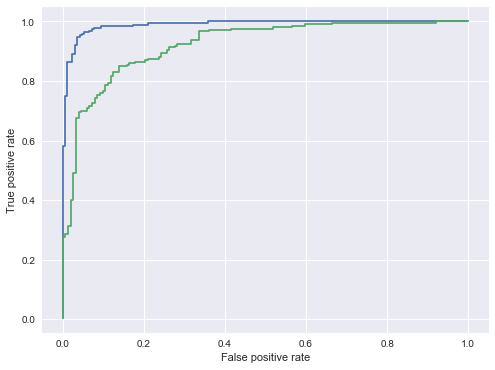

In [33]:
fpr_t, tpr_t, thres_t = roc_curve(test_y, pred_test_lr)
fpr_v, tpr_v, thres_v = roc_curve(valid_y, pred_valid_lr)

print('ROC AUC Score on test set:      ', roc_auc_score(test_y, pred_test_lr))
print('ROC AUC Score on validation set:', roc_auc_score(valid_y, pred_valid_lr))

fig = plt.figure(figsize=(8,6))
plt.plot(fpr_t, tpr_t, '-')
plt.plot(fpr_v, tpr_v, '-')
plt.ylabel('True positive rate')
plt.xlabel('False positive rate')
plt.savefig('../report/img/roc-linear-expl-lr.svg')
plt.show()

## Cleaning Training set

In [ ]:
# Cleaning validation set
e = r"([^\n]+\n)*\n((.|\s)*)$" # Matching header
p = re.compile(e, re.MULTILINE)

clean = []

for d in train_x + test_x:
    no_head = p.match(d).group(2)
    # Then removing quotes: lines starting by an email address or >
    no_quotes = re.sub(r"([a-zA-Z0-9_.+-]+@[a-zA-Z0-9-]+\.[a-zA-Z0-9-.]+|>|(In article)|(In <)).*\n", "", no_head)
    clean.append(no_quotes)
    
train_x_clean = clean[:len(train_x)]
test_x_clean  = clean[len(train_x):]

In [ ]:
# New model
# Retraining a similar model:
tfidf = TfidfVectorizer()
tfidf.fit(train_x_clean)
train_clean_tfidf = tfidf.transform(train_x_clean)
test_clean_tfidf  = tfidf.transform(test_x_clean)
valid_tfidf = tfidf.transform(valid_x)

rf = RandomForestClassifier(n_estimators=300, max_depth=8)
rf.fit(train_clean_tfidf, train_y)

pred_test  = rf.predict_proba(test_clean_tfidf)
pred_valid = rf.predict_proba(valid_tfidf)

print('ROC AUC Score on test set:      ', roc_auc_score(test_y, pred_test[:,1]))
print('ROC AUC Score on validation set:', roc_auc_score(valid_y, pred_valid[:,1]))

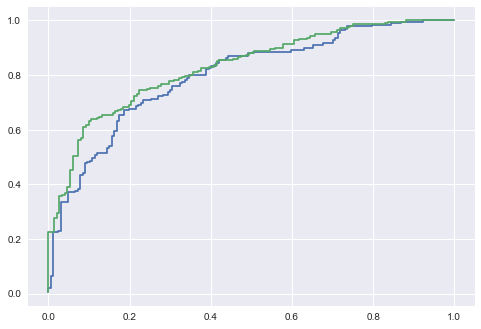

In [27]:
fpr_t, tpr_t, thres_t = roc_curve(test_y, pred_test[:,1])
fpr_v, tpr_v, thres_v = roc_curve(valid_y, pred_valid[:,1])

plt.plot(fpr_t, tpr_t, '-', label="test")
plt.plot(fpr_v, tpr_v, '-', label="validation")

plt.show()